In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
import folium

## 부산 용도 지역

In [2]:
lsmd = gpd.read_file('converted_exported.shp',encoding='cp949')

### MNUM 기준 부산시 주거지역 필터링하기
##### 지정권자(7)+시도코드(2)+시군구코드(3)+고시년도(4)+고시번호(4)+
##### 용도지역지구코드(6)+도면표시번호본번(4)+도면표시번호부번(3)

In [3]:
lsmd['지정권자'] = lsmd['MNUM'].str.slice(0, 7)
lsmd['시도코드'] = lsmd['MNUM'].str.slice(7, 9)
lsmd['시군구코드'] = lsmd['MNUM'].str.slice(9, 12)
lsmd['고시년도'] = lsmd['MNUM'].str.slice(12, 16)
lsmd['고시번호'] = lsmd['MNUM'].str.slice(16, 20)
lsmd['용도지역지구코드'] = lsmd['MNUM'].str.slice(20, 26)
lsmd['도면표시번호본번'] = lsmd['MNUM'].str.slice(26, 30)
lsmd['도면표시번호부번'] = lsmd['MNUM'].str.slice(30, 33)
lsmd

,MNUM,SGG_OID,COL_ADM_SE,NTFDATE,ALIAS,REMARK,geometry,지정권자,시도코드,시군구코드,고시년도,고시번호,용도지역지구코드,도면표시번호본번,도면표시번호부번
0,62600002611020050001UQA3300001001,116,26110,None,None,None,"POLYGON ((129.04009 35.11143, 129.04140 35.111...",6260000,26,110,2005,0001,UQA330,0001,001
1,15000002611019990000UQA3300000008,118,26110,None,None,None,"POLYGON ((129.03404 35.09686, 129.03406 35.096...",1500000,26,110,1999,0000,UQA330,0000,008
2,62600002611020100066UQA2200001007,138,26110,None,None,None,"POLYGON ((129.03726 35.09799, 129.03728 35.098...",6260000,26,110,2010,0066,UQA220,0001,007
3,62600002611020050004UQA2200001001,119,26110,None,None,None,"POLYGON ((129.03770 35.10536, 129.03612 35.105...",6260000,26,110,2005,0004,UQA220,0001,001
4,62600002611020050002UQA4300001001,803,26110,None,None,None,"POLYGON ((129.03134 35.10099, 129.03139 35.100...",6260000,26,110,2005,0002,UQA430,0001,001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3022,62600002671020230193UQA1300004002,16148,26710,None,None,None,"POLYGON ((129.23630 35.31636, 129.23653 35.316...",6260000,26,710,2023,0193,UQA130,0004,002
3023,62600002671020230193UQA1300004001,16149,26710,None,None,None,"POLYGON ((129.23736 35.32125, 129.23766 35.321...",6260000,26,710,2023,0193,UQA130,0004,001
3024,62600002671020230193UQA1230003001,16150,26710,None,None,None,"POLYGON ((129.23677 35.31629, 129.23804 35.319...",6260000,26,710,2023,0193,UQA123,0003,001
3025,62600002671020230193UQA1220002001,16151,26710,None,None,None,"POLYGON ((129.23604 35.31540, 129.23649 35.316...",6260000,26,710,2023,0193,UQA122,0002,001


In [4]:
# 부산 시도코드 27
lsmd = lsmd[(lsmd['용도지역지구코드'] == 'UQA100') |
                (lsmd['용도지역지구코드'] == 'UQA110') |
                (lsmd['용도지역지구코드'] == 'UQA111') |
                (lsmd['용도지역지구코드'] == 'UQA112') |
                (lsmd['용도지역지구코드'] == 'UQA120') |
                (lsmd['용도지역지구코드'] == 'UQA121') |
                (lsmd['용도지역지구코드'] == 'UQA122') |
                (lsmd['용도지역지구코드'] == 'UQA123') |
                (lsmd['용도지역지구코드'] == 'UQA130')]
lsmd

,MNUM,SGG_OID,COL_ADM_SE,NTFDATE,ALIAS,REMARK,geometry,지정권자,시도코드,시군구코드,고시년도,고시번호,용도지역지구코드,도면표시번호본번,도면표시번호부번
5,32500002611020180047UQA1220001001,1426,26110,20181206,None,None,"POLYGON ((129.03112 35.10580, 129.03191 35.107...",3250000,26,110,2018,0047,UQA122,0001,001
6,62600002611020050007UQA1230001001,97,26110,None,None,None,"POLYGON ((129.02417 35.10889, 129.02416 35.108...",6260000,26,110,2005,0007,UQA123,0001,001
7,62600002611020050010UQA1230001001,98,26110,None,None,None,"POLYGON ((129.03442 35.10871, 129.03442 35.108...",6260000,26,110,2005,0010,UQA123,0001,001
9,62600002611020050014UQA1230001001,99,26110,None,None,None,"POLYGON ((129.03179 35.10766, 129.03174 35.107...",6260000,26,110,2005,0014,UQA123,0001,001
10,62600002611020050002UQA1220001001,101,26110,None,None,None,"POLYGON ((129.03022 35.10645, 129.03021 35.106...",6260000,26,110,2005,0002,UQA122,0001,001
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3022,62600002671020230193UQA1300004002,16148,26710,None,None,None,"POLYGON ((129.23630 35.31636, 129.23653 35.316...",6260000,26,710,2023,0193,UQA130,0004,002
3023,62600002671020230193UQA1300004001,16149,26710,None,None,None,"POLYGON ((129.23736 35.32125, 129.23766 35.321...",6260000,26,710,2023,0193,UQA130,0004,001
3024,62600002671020230193UQA1230003001,16150,26710,None,None,None,"POLYGON ((129.23677 35.31629, 129.23804 35.319...",6260000,26,710,2023,0193,UQA123,0003,001
3025,62600002671020230193UQA1220002001,16151,26710,None,None,None,"POLYGON ((129.23604 35.31540, 129.23649 35.316...",6260000,26,710,2023,0193,UQA122,0002,001


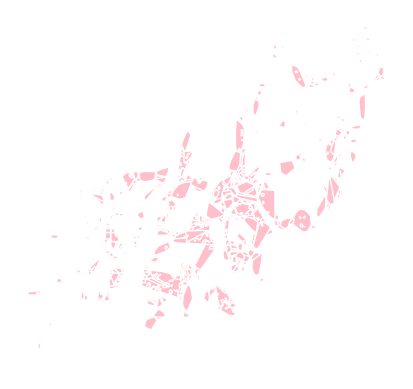

In [5]:
ax = lsmd.convex_hull.plot(color='pink', edgecolor="w")          
ax.set_axis_off()                            # 축제거
plt.show()

## 부산 지도

In [6]:
m = folium.Map(location=[35.14,129.06],
               zoom_start=10,
               tiles="cartodb positron"
              )

In [7]:
for _, lsmd_data in lsmd.iterrows():
    folium.GeoJson(lsmd_data['geometry']).add_to(m)
m

## 행정동 표시하기

In [8]:
# GeoJSON 파일 경로
geojson_file = 'HangJeongDong_ver20230701.geojson'

# GeoPandas를 사용하여 GeoJSON 파일 읽기
gdf = gpd.read_file(geojson_file)

# "sido" 열의 값이 '26'인 행만 선택
selected_gdf = gdf[gdf["sido"] == '26']

# 선택된 GeoPandas 데이터프레임을 Folium 맵으로 변환
m = folium.Map(location=[selected_gdf['geometry'].centroid.y.mean(), selected_gdf['geometry'].centroid.x.mean()],
               zoom_start=10,
               tiles="cartodbpositron")

# 선택된 GeoPandas 데이터프레임의 각 지오메트리를 Folium 지오메트리로 추가
for _, geojson_data in selected_gdf.iterrows():
    folium.GeoJson(geojson_data['geometry']).add_to(m)

# Folium 맵을 표시
m

C:\Users\ssj95\AppData\Local\Temp\ipykernel_4404\1136568013.py:11: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  m = folium.Map(location=[selected_gdf['geometry'].centroid.y.mean(), selected_gdf['geometry'].centroid.x.mean()],


### 행정동 면적 구하기

In [9]:
import geopandas as gpd

# GeoJSON 파일 경로
geojson_file = 'HangJeongDong_ver20230701.geojson'

# GeoPandas를 사용하여 GeoJSON 파일 읽기
gdf = gpd.read_file(geojson_file)

# "sido"가 '26'인 행만 선택
selected_gdf = gdf[gdf["sido"] == '26']

# 면적을 새로운 열인 'area'에 추가
selected_gdf['area'] = selected_gdf['geometry'].to_crs({'init': 'epsg:6933'}).map(lambda x: round(x.area, 2))

# 결과 출력
print(selected_gdf[['temp', 'area']])

# csv파일로 저장
selected_gdf.to_csv('busan_area.csv', index=False, encoding='cp949')

           temp        area
424      중구 중앙동   725468.62
425      중구 동광동   157247.05
426      중구 대청동   352028.15
427      중구 보수동   417831.91
428      중구 부평동   223515.66
...         ...         ...
3409   해운대구 우3동   940096.63
3410  부산진구 범천1동   548751.86
3420  부산진구 범천2동  1650001.03
3423   강서구 명지2동  1675993.81
3451   금정구 장전2동  3427623.50

[205 rows x 2 columns]


C:\Users\ssj95\anaconda3\envs\pknu_base\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\ssj95\anaconda3\envs\pknu_base\lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


### 겹치는 면적 구하기

In [13]:
# 행정동 폴리곤 데이터와 주거지역 폴리곤 데이터 오버레이
overlay = gpd.overlay(lsmd, gdf, how='intersection')

In [14]:
# 오버레이된 데이터에서 각 폴리곤의 면적 계산
overlay['area'] = overlay['geometry'].to_crs({'init': 'epsg:6933'}).map(lambda x: round(x.area, 2))

C:\Users\ssj95\anaconda3\envs\pknu_base\lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [17]:
# 행정동 별로 그룹화하고 면적의 합계를 계산
area_by_dong = overlay.groupby('temp')['area'].sum()

# 결과 확인
print(area_by_dong)

temp
강서구 가덕도동     582646.22
강서구 가락동     1407255.69
강서구 강동동     4846773.60
강서구 녹산동     2888940.58
강서구 대저1동    3725864.95
               ...    
해운대구 좌2동     706344.23
해운대구 좌3동     532757.92
해운대구 좌4동     548379.80
해운대구 중1동     673259.40
해운대구 중2동     823532.23
Name: area, Length: 201, dtype: float64


In [39]:
area_by_dong

temp
강서구 가덕도동     582646.22
강서구 가락동     1407255.69
강서구 강동동     4846773.60
강서구 녹산동     2888940.58
강서구 대저1동    3725864.95
               ...    
해운대구 좌2동     706344.23
해운대구 좌3동     532757.92
해운대구 좌4동     548379.80
해운대구 중1동     673259.40
해운대구 중2동     823532.23
Name: area, Length: 201, dtype: float64

In [37]:
import random

m = folium.Map(location=[35.14,129.06],
               zoom_start=10,
               tiles="cartodb positron"
              )

# 첫 번째 폴리곤은 파란색으로 표시
for _, lsmd_data in lsmd.iterrows():
    folium.GeoJson(lsmd_data['geometry'], style_function=lambda x: {'fillColor': 'blue', 'fillOpacity':0.35,'color':'none'}).add_to(m)


# GeoJSON 파일 경로
geojson_file = 'HangJeongDong_ver20230701.geojson'

# GeoPandas를 사용하여 GeoJSON 파일 읽기
gdf = gpd.read_file(geojson_file)

# "sido" 열의 값이 '26'인 행만 선택
selected_gdf = gdf[gdf["sido"] == '26']

# 두 번째 폴리곤은 투명도가 있는 빨간색으로 표시
for _, geojson_data in selected_gdf.iterrows():
    folium.GeoJson(geojson_data['geometry'], style_function=lambda x: {'fillColor': 'red', 'fillOpacity': 0}).add_to(m)

#
# Folium 맵을 표시
m

### 주거면적 열 추가하기

In [42]:
# CSV 파일 읽기
df = pd.read_csv('busan_area.csv',encoding='cp949')


# '주거지역면적' 새로운 열 추가
df['주거지역면적'] = df['temp'].map(area_by_dong)

# 업데이트된 데이터프레임을 다시 CSV 파일로 저장
df.to_csv('busan_residential_area.csv', index=False)

In [46]:
df2 = pd.read_csv('busan_residential_area.csv')

# '면적대비 주거지역면적 비율' 열 추가
df2['면적대비 주거지역면적 비율'] = df2['주거지역면적'] / df2['area']

# NaN 값 처리 (옵션)
df2['면적대비 주거지역면적 비율'] = df2['면적대비 주거지역면적 비율'].fillna(0)

df2['면적대비 주거지역면적 비율'] = df2['면적대비 주거지역면적 비율'].round(2)

# 업데이트된 데이터프레임을 다시 CSV 파일로 저장
df2.to_csv('busan_residential_area_complete.csv', index=False)